In [ ]:
from bs4 import BeautifulSoup
import requests
import re
import pandas as pd
from nltk.tokenize import sent_tokenize

def get_novel(url: str) -> str:
    """
    Fetches the raw text of a novel from Project Gutenberg.
    Automatically handles conversion from HTML URL to raw .txt format.

    Args:
        url (str): The Project Gutenberg URL (HTML or .txt).

    Returns:
        str: The raw text of the novel.
    """
    # Convert HTML-style Gutenberg book URL to raw .txt format
    if "gutenberg.org/ebooks/" in url:
        book_id = url.rstrip("/").split("/")[-1]
        url = f"https://www.gutenberg.org/cache/epub/{book_id}/pg{book_id}.txt"

    # Fetch the content
    resp = requests.get(url)
    resp.raise_for_status()  # Raise an error if the request failed

    # Handle content type
    content_type = resp.headers.get("Content-Type", "")
    if "html" in content_type:
        soup = BeautifulSoup(resp.content, "html.parser")
        raw_text = soup.get_text()
    else:
        raw_text = resp.text

    return raw_text



# def extract_chapters_from_html(raw_text):
#     """
#     Extracts chapters and their text from HTML content using BeautifulSoup.
#     Returns a DataFrame with columns 'chapter_number' and 'raw_text'.

#     Args:
#         raw_text (str): The HTML content of the novel.

#     Returns:
#         pd.DataFrame: DataFrame with columns 'chapter_number' and 'raw_text'.
#     """
#     soup = BeautifulSoup(raw_text, "html.parser")
#     chapters = []
#     current_text = []
#     chapter_number = 0
#     # Find all tags that could indicate a chapter heading
#     for tag in soup.find_all(['h2', 'p']):
#         if tag.name in ['h2']:
#             if current_text:
#                 chapters.append({
#                     "chapter_number": chapter_number,
#                     "raw_text": " ".join(current_text)
#                 })
#                 current_text = []
#             chapter_number += 1
#         elif tag.name == 'p':
#             current_text.append(tag.get_text(strip=True))
#     # Add the last chapter if any text remains
#     if current_text:
#         chapters.append({
#             "chapter_number": chapter_number,
#             "raw_text": " ".join(current_text)
#         })
#     return pd.DataFrame(chapters)


import requests
from bs4 import BeautifulSoup
import pandas as pd

def get_novel_with_chapters(url: str):
    """
    Fetches the HTML of a novel from Project Gutenberg and extracts chapters.
    Returns a DataFrame with columns 'chapter_number' and 'raw_text'.
    """
    # Convert HTML-style Gutenberg book URL to raw .txt format if needed
    if "gutenberg.org/ebooks/" in url:
        book_id = url.rstrip("/").split("/")[-1]
        url = f"https://www.gutenberg.org/cache/epub/{book_id}/pg{book_id}-images.html"

    # Fetch the content
    resp = requests.get(url, timeout=20)
    resp.raise_for_status()

    # Parse the HTML content using BeautifulSoup
    soup = BeautifulSoup(resp.content, "html.parser")
    chapters = []         # List to store chapter data
    current_text = []     # Buffer for accumulating text of the current chapter
    chapter_number = 0    # Counter for chapter numbers

    # Iterate through all <h2> and <p> tags (common in Gutenberg HTML)
    for tag in soup.find_all(['h2', 'p']):
        if tag.name == 'h2':
            # If we hit a new chapter heading, save the previous chapter (if any)
            if current_text:
                chapters.append({
                    "chapter_number": chapter_number,
                    "raw_text": " ".join(current_text)
                })
                current_text = []
            chapter_number += 1  # Increment chapter number for new chapter
        elif tag.name == 'p':
            # Accumulate paragraph text for the current chapter
            current_text.append(tag.get_text(strip=True))
    # After loop, save any remaining text as the last chapter
    if current_text:
        chapters.append({
            "chapter_number": chapter_number,
            "raw_text": " ".join(current_text)
        })
    # Return chapters as a DataFrame
    return pd.DataFrame(chapters)



def clean_gutenberg_text(raw_text: str) -> str:
    # Remove BOM if present
    raw_text = raw_text.lstrip("\ufeff")
    # Markers to locate main content
    start_marker = r"\*\*\* START OF THE PROJECT GUTENBERG EBOOK"
    end_marker   = r"\*\*\* END OF THE PROJECT GUTENBERG EBOOK"
    start_match = re.search(start_marker, raw_text, re.IGNORECASE)
    end_match   = re.search(end_marker, raw_text, re.IGNORECASE)
    if start_match and end_match:
        content = raw_text[start_match.end():end_match.start()]
    else:
        # Fallback if markers not found
        content = raw_text
    # Normalize line endings and whitespace
    content = re.sub(r"\r\n", "\n", content)              # unify line endings
    content = re.sub(r"\n{2,}", "\n\n", content)          # collapse multiple blank lines
    content = re.sub(r"[ \t]+", " ", content)             # collapse spaces/tabs
    content = content.strip()
    return content


import pandas as pd
import nltk
from nltk.tokenize import sent_tokenize

def preprocessing(content):
    # Lowercase
    content = content.lower()

    # Remove numbers
    content = ''.join([char for char in content if not char.isdigit()])

    # Remove punctuation
    punctuation = ['!','"','#','$','%','&','(',')',
                   '*','+','-','/',':',';','<',
                   '=','>','@',"\\",'"]"','^','_']


    for punct in punctuation:
        content = content.replace(punct, ' ')

    # Tokenize (split into words)
    tokens = content.split()

    return ' '.join(tokens)


# def chunk_by_sentences(content, sentences_per_chunk=3):
#     sentences = sent_tokenize(content)
#     chunks = []

#     for i in range(0, len(sentences), sentences_per_chunk):
#         chunk = sentences[i:i+sentences_per_chunk]
#         chunks.append(" ".join(chunk))
#     df = pd.DataFrame({'chunk': chunks})
#     return df

# chunks = chunk_by_sentences(data, sentences_per_chunk=10)

# Create DataFrame with each chunk as a row
# df = pd.DataFrame({'chunk': chunks})

# df["cleaned_chunk"] = df["chunk"].apply(preprocessing)


# Load your DataFrame (assuming it's called df)

# Apply model to DataFrame (assuming df["chunk"] exists)

# Print results


def chunk_by_sentences_with_chapters(chapters, sentences_per_chunk=3):
    """
    Splits the text of each chapter into chunks of N sentences and keeps chapter info.

    Args:
        chapters (list of dict): Output from extract_chapters_from_html, each dict has 'chapter' and 'text'.
        sentences_per_chunk (int): Number of sentences per chunk.

    Returns:
        pd.DataFrame: DataFrame with columns 'chunk' and 'chapter'.
    """
    from nltk.tokenize import sent_tokenize
    import pandas as pd

    data = []
    for chapter in chapters:
        sentences = sent_tokenize(chapter["text"])
        for i in range(0, len(sentences), sentences_per_chunk):
            chunk = " ".join(sentences[i:i+sentences_per_chunk])
            data.append({"chunk": chunk, "chapter": chapter["chapter"]})
    return pd.DataFrame(data)


import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification

# Load GoEmotions tokenizer and model
tokenizer = AutoTokenizer.from_pretrained("SamLowe/roberta-base-go_emotions")
model = AutoModelForSequenceClassification.from_pretrained("SamLowe/roberta-base-go_emotions")

# Get ID-to-label mapping
id2label = model.config.id2label

def predict_emotions(df, text_column="chunk"):
    predicted_ids = []
    predicted_labels = []

    for text in df[text_column]:
        inputs = tokenizer(text, return_tensors="pt", truncation=True, padding=True, max_length=512)
        with torch.no_grad():
            outputs = model(**inputs)
        probs = torch.nn.functional.softmax(outputs.logits, dim=-1)
        pred_id = torch.argmax(probs, dim=-1).item()
        predicted_ids.append(pred_id)
        predicted_labels.append(id2label[pred_id])

    df["Predicted_Emotion_ID"] = predicted_ids
    df["Predicted_Emotion"] = predicted_labels
    return df


# Usage:
# chapters = extract_chapters_from_html(raw_text)
# df = chunk_by_sentences_with_chapters(chapters, sentences_per_chunk=3)


In [2]:
"""this is the code from Dorothee"""

from bs4 import BeautifulSoup
import requests
import re

def get_novel(url: str) -> str:
    """
    Fetches the raw text of a novel from Project Gutenberg.
    Automatically handles conversion from HTML URL to raw .txt format.

    Args:
        url (str): The Project Gutenberg URL (HTML or .txt).

    Returns:
        str: The raw text of the novel.
    """
    # Convert HTML-style Gutenberg book URL to raw .txt format
    if "gutenberg.org/ebooks/" in url:
        book_id = url.rstrip("/").split("/")[-1]
        url = f"https://www.gutenberg.org/cache/epub/{book_id}/pg{book_id}.txt"

    # Fetch the content
    resp = requests.get(url)
    resp.raise_for_status()  # Raise an error if the request failed

    # Handle content type
    content_type = resp.headers.get("Content-Type", "")
    if "html" in content_type:
        soup = BeautifulSoup(resp.content, "html.parser")
        raw_text = soup.get_text()
    else:
        raw_text = resp.text

    return raw_text



def clean_gutenberg_text(raw_text: str) -> str:
    # Remove BOM if present
    raw_text = raw_text.lstrip("\ufeff")
    # Markers to locate main content
    start_marker = r"\*\*\* START OF THE PROJECT GUTENBERG EBOOK"
    end_marker   = r"\*\*\* END OF THE PROJECT GUTENBERG EBOOK"
    start_match = re.search(start_marker, raw_text, re.IGNORECASE)
    end_match   = re.search(end_marker, raw_text, re.IGNORECASE)
    if start_match and end_match:
        content = raw_text[start_match.end():end_match.start()]
    else:
        # Fallback if markers not found
        content = raw_text
    # Normalize line endings and whitespace
    content = re.sub(r"\r\n", "\n", content)              # unify line endings
    content = re.sub(r"\n{2,}", "\n\n", content)          # collapse multiple blank lines
    content = re.sub(r"[ \t]+", " ", content)             # collapse spaces/tabs
    content = content.strip()
    return content


In [3]:
import pandas as pd
import nltk
from nltk.tokenize import sent_tokenize

def preprocessing(content):
    # Lowercase
    content = content.lower()

    # Remove numbers
    content = ''.join([char for char in content if not char.isdigit()])

    # Remove punctuation
    punctuation = ['!','"','#','$','%','&','(',')',
                   '*','+','-','/',':',';','<',
                   '=','>','@',"\\",'"]"','^','_']


    for punct in punctuation:
        content = content.replace(punct, ' ')

    # Tokenize (split into words)
    tokens = content.split()

    return ' '.join(tokens)


def chunk_by_sentences(content, sentences_per_chunk=3):
    sentences = sent_tokenize(content)
    chunks = []

    for i in range(0, len(sentences), sentences_per_chunk):
        chunk = sentences[i:i+sentences_per_chunk]
        chunks.append(" ".join(chunk))
    df = pd.DataFrame({'chunk': chunks})
    return df

# chunks = chunk_by_sentences(data, sentences_per_chunk=10)

# Create DataFrame with each chunk as a row
# df = pd.DataFrame({'chunk': chunks})

# df["cleaned_chunk"] = df["chunk"].apply(preprocessing)

In [4]:
import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification

# Load GoEmotions tokenizer and model
tokenizer = AutoTokenizer.from_pretrained("SamLowe/roberta-base-go_emotions")
model = AutoModelForSequenceClassification.from_pretrained("SamLowe/roberta-base-go_emotions")

# Get ID-to-label mapping
id2label = model.config.id2label

def predict_emotions(df, text_column="chunk"):
    predicted_ids = []
    predicted_labels = []

    for text in df[text_column]:
        inputs = tokenizer(text, return_tensors="pt", truncation=True, padding=True, max_length=512)
        with torch.no_grad():
            outputs = model(**inputs)
        probs = torch.nn.functional.softmax(outputs.logits, dim=-1)
        pred_id = torch.argmax(probs, dim=-1).item()
        predicted_ids.append(pred_id)
        predicted_labels.append(id2label[pred_id])

    df["Predicted_Emotion_ID"] = predicted_ids
    df["Predicted_Emotion"] = predicted_labels
    return df



# Load your DataFrame (assuming it's called df)

# Apply model to DataFrame (assuming df["chunk"] exists)

# Print results

/Users/magdalenarepp/.pyenv/versions/3.10.6/envs/emotionplot2/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [5]:
raw_text = get_novel("https://www.gutenberg.org/cache/epub/1661/pg1661-images.html")

In [60]:
raw_text

'\n\n\n\r\n      The Adventures of Sherlock Holmes | Project Gutenberg\r\n    \n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\nThe Project Gutenberg eBook of The Adventures of Sherlock Holmes\nThis ebook is for the use of anyone anywhere in the United States and\r\nmost other parts of the world at no cost and with almost no restrictions\r\nwhatsoever. You may copy it, give it away or re-use it under the terms\r\nof the Project Gutenberg License included with this ebook or online\r\nat www.gutenberg.org. If you are not located in the United States,\r\nyou will have to check the laws of the country where you are located\r\nbefore using this eBook.\nTitle: The Adventures of Sherlock Holmes\n\nAuthor: Arthur Conan Doyle\n\nRelease date: March 1, 1999 [eBook #1661]\r\n                Most recently updated: October 10, 2023\nLanguage: English\nCredits: an anonymous Project Gutenberg volunteer and Jose Menendez\n\n*** START OF THE PROJECT GUTENBERG EBOOK THE ADVENTURES OF SHERLOCK HOLMES ***\n\n\n

In [6]:
content = clean_gutenberg_text(raw_text)

In [ ]:
content

'THE ADVENTURES OF SHERLOCK HOLMES ***\n\nTHERE IS AN ILLUSTRATED EDITION OF THIS TITLE WHICH MAY VIEWED AT EBOOK \n[ #48320 ]\n\nThe Adventures of Sherlock Holmes\nby Arthur Conan Doyle\n\nContents\n\nI. A Scandal in Bohemia\n\nII. The Red-Headed League\n\nIII. A Case of Identity\n\nIV. The Boscombe Valley Mystery\n\nV. The Five Orange Pips\n\nVI. The Man with the Twisted Lip\n\nVII. The Adventure of the Blue Carbuncle\n\nVIII. The Adventure of the Speckled Band\n\nIX. The Adventure of the Engineer’s Thumb\n\nX. The Adventure of the Noble Bachelor\n\nXI. The Adventure of the Beryl Coronet\n\nXII. The Adventure of the Copper Beeches\n\nI.A SCANDAL IN BOHEMIA\nI.\n\nTo Sherlock Holmes she\nis always the woman. I have seldom heard him mention her under any other\nname. In his eyes she eclipses and predominates the whole of her sex. It was\nnot that he felt any emotion akin to love for Irene Adler. All emotions, and\nthat one particularly, were abhorrent to his cold, precise but admirably

In [7]:
content = preprocessing(content)

In [ ]:
content

'the adventures of sherlock holmes there is an illustrated edition of this title which may viewed at ebook [ ] the adventures of sherlock holmes by arthur conan doyle contents i. a scandal in bohemia ii. the red headed league iii. a case of identity iv. the boscombe valley mystery v. the five orange pips vi. the man with the twisted lip vii. the adventure of the blue carbuncle viii. the adventure of the speckled band ix. the adventure of the engineer’s thumb x. the adventure of the noble bachelor xi. the adventure of the beryl coronet xii. the adventure of the copper beeches i.a scandal in bohemia i. to sherlock holmes she is always the woman. i have seldom heard him mention her under any other name. in his eyes she eclipses and predominates the whole of her sex. it was not that he felt any emotion akin to love for irene adler. all emotions, and that one particularly, were abhorrent to his cold, precise but admirably balanced mind. he was, i take it, the most perfect reasoning and obse

In [8]:
df = chunk_by_sentences(content, sentences_per_chunk=10)

In [ ]:
df

,chunk
0,the adventures of sherlock holmes there is an ...
1,i have seldom heard him mention her under any ...
2,i had seen little of holmes lately. my marriag...
3,"to me, who knew his every mood and habit, his ..."
4,"“indeed, i should have thought a little more. ..."
...,...
447,"that is how he did it.” “but it is impossible,..."
448,"“i have my revolver,” said i. “better close th..."
449,with much labour we separated them and carried...
450,"“she was never happy at home, miss alice wasn’..."


In [ ]:
df["chunk"].iloc[74]

'i expect that within an hour matters will come to a head. in the meantime mr. merryweather, we must put the screen over that dark lantern.” “and sit in the dark?” “i am afraid so. i had brought a pack of cards in my pocket, and i thought that, as we were a partie carrée, you might have your rubber after all. but i see that the enemy’s preparations have gone so far that we cannot risk the presence of a light. and, first of all, we must choose our positions. these are daring men, and though we shall take them at a disadvantage, they may do us some harm unless we are careful. i shall stand behind this crate, and do you conceal yourselves behind those. then, when i flash a light upon them, close in swiftly. if they fire, watson, have no compunction about shooting them down.” i placed my revolver, cocked, upon the top of the wooden case behind which i crouched. holmes shot the slide across the front of his lantern and left us in pitch darkness—such an absolute darkness as i have never befo

In [9]:
predict_emotions(df, text_column="chunk")

,chunk,Predicted_Emotion_ID,Predicted_Emotion
0,the adventures of sherlock holmes there is an ...,27,neutral
1,i have seldom heard him mention her under any ...,27,neutral
2,i had seen little of holmes lately. my marriag...,27,neutral
3,"to me, who knew his every mood and habit, his ...",27,neutral
4,"“indeed, i should have thought a little more. ...",27,neutral
...,...,...,...
447,"that is how he did it.” “but it is impossible,...",27,neutral
448,"“i have my revolver,” said i. “better close th...",14,fear
449,with much labour we separated them and carried...,27,neutral
450,"“she was never happy at home, miss alice wasn’...",27,neutral


In [ ]:
# id2label

In [12]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_emotions_over_time(df, emotion_column="Predicted_Emotion"):
    # Map emotions to numeric values for plotting
    emotion_to_int = {emotion: idx for idx, emotion in enumerate(sorted(df[emotion_column].unique()))}
    int_to_emotion = {v: k for k, v in emotion_to_int.items()}

    df["Emotion_Index"] = df[emotion_column].map(emotion_to_int)

    # Plot
    plt.figure(figsize=(15, 5))
    plt.plot(df.index, df["Emotion_Index"], marker='o', linestyle='-', alpha=0.7)
    plt.yticks(list(int_to_emotion.keys()), list(int_to_emotion.values()))
    plt.xlabel("Chunk Number")
    plt.ylabel("Predicted Emotion")
    plt.title("Emotions Over Time in the Novel")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

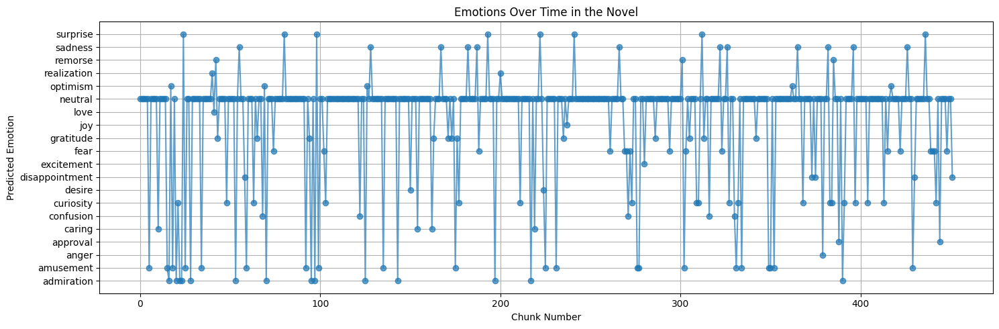

In [ ]:
plot_emotions_over_time(df, emotion_column="Predicted_Emotion")

# Trying other model

In [13]:
df_other_model = chunk_by_sentences(content, sentences_per_chunk=2)

In [14]:
from transformers import pipeline

# Load the emotion classification pipeline
classifier = pipeline(
    task="text-classification",
    model="SamLowe/roberta-base-go_emotions",
    top_k=None  # Return all possible emotion labels
)

# Load the CSV file
# df = pd.read_csv("/home/dorothee/code/magadare/emotionplot2/raw_data/emotion_sentimen_dataset.csv")
# df = df.head(250)

# Classify each phrase
phrases = df_other_model["chunk"].tolist()
results = classifier(phrases)

# Filter emotions with score above threshold
def filter_emotions(scores, threshold=0.2):
    return {s["label"]: round(s["score"], 3) for s in scores if s["score"] > threshold}

df_other_model["emotions"] = [filter_emotions(r, threshold=0.5) for r in results]

Device set to use mps:0


In [15]:
df_other_model

,chunk,emotions
0,the adventures of sherlock holmes there is an ...,{'neutral': 0.958}
1,a case of identity iv. the boscombe valley mys...,{'neutral': 0.966}
2,the man with the twisted lip vii. the adventur...,{'neutral': 0.966}
3,the adventure of the speckled band ix. the adv...,{'neutral': 0.968}
4,the adventure of the beryl coronet xii. the ad...,{'neutral': 0.958}
...,...,...
2253,"then she got better at last, all worn to a sha...",{'neutral': 0.536}
2254,"fowler was a very kind spoken, free handed gen...",{}
2255,and here comes the country surgeon and mrs. ru...,{'neutral': 0.661}
2256,"they still live with their old servants, who p...",{'neutral': 0.928}


In [26]:
emotions_df = df_other_model["emotions"].apply(pd.Series).fillna(0)
emotions_df

,neutral,admiration,sadness,amusement,approval,curiosity,caring,optimism,surprise,disapproval,...,gratitude,desire,disappointment,confusion,joy,annoyance,fear,anger,excitement,nervousness
0,0.958,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.966,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.966,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.968,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.958,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2253,0.536,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2254,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2255,0.661,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2256,0.928,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0


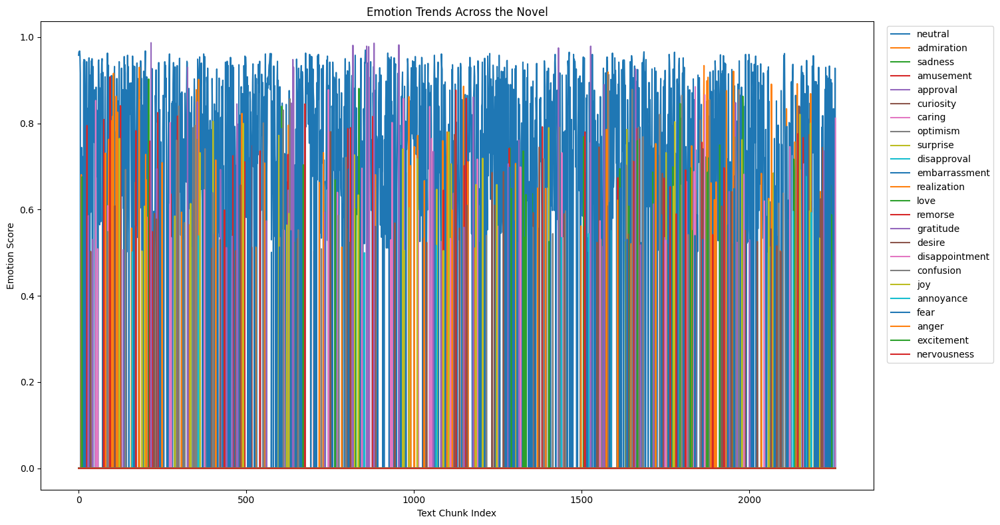

In [ ]:
# Emotion trends over time

import matplotlib.pyplot as plt

emotions_df.reset_index(drop=True, inplace=True)

plt.figure(figsize=(15, 8))
for emotion in emotions_df.columns:
    plt.plot(emotions_df.index, emotions_df[emotion], label=emotion)

plt.title("Emotion Trends Across the Novel")
plt.xlabel("Text Chunk Index")
plt.ylabel("Emotion Score")
plt.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
plt.tight_layout()
plt.show()

/var/folders/cp/cxk4jwt93v1361qhthc_qgtc0000gn/T/ipykernel_23753/534801024.py:14: UserWarning: Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/Users/magdalenarepp/.pyenv/versions/3.10.6/envs/emotionplot2/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


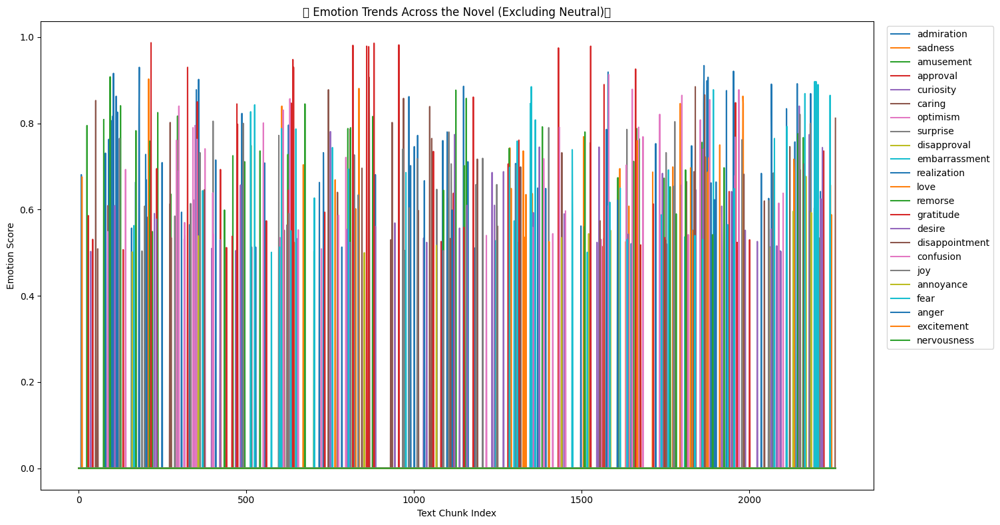

In [ ]:
import matplotlib.pyplot as plt

emotions_df.reset_index(drop=True, inplace=True)

plt.figure(figsize=(15, 8))
for emotion in emotions_df.columns:
    if emotion != "neutral":
        plt.plot(emotions_df.index, emotions_df[emotion], label=emotion)

plt.title("📈 Emotion Trends Across the Novel (Excluding Neutral)📈")
plt.xlabel("Text Chunk Index")
plt.ylabel("Emotion Score")
plt.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
plt.tight_layout()
plt.show()


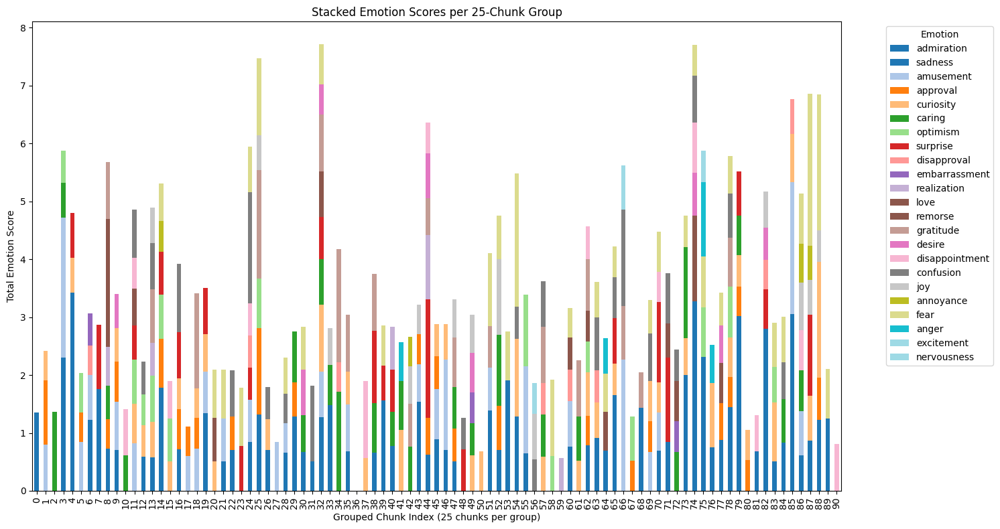

In [ ]:
import matplotlib.pyplot as plt

"""
- The emotion score represents the model’s confidence or probability that a specific emotion is present in a given text chunk.
- The height of each colored segment in a bar shows the summed emotion scores for that emotion across a group of 25 chunks.
- The total height of a bar shows the overall emotional intensity (sum of all emotion scores) for that group of chunks.
"""

# Exclude "neutral" if you don't want it in the plot
emotions_to_plot = [col for col in emotions_df.columns if col != "neutral"]

# Group every 25 chunks together and sum their emotion scores
group_size = 25
grouped = emotions_df[emotions_to_plot].groupby(emotions_df.index // group_size).sum()

# Plot
fig, ax = plt.subplots(figsize=(15, 8))
grouped.plot(
    kind='bar',
    stacked=True,
    ax=ax,
    colormap='tab20'
)

ax.set_xlabel("Grouped Chunk Index (25 chunks per group)")
ax.set_ylabel("Total Emotion Score")
ax.set_title("Stacked Emotion Scores per 25-Chunk Group")
ax.legend(title="Emotion", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

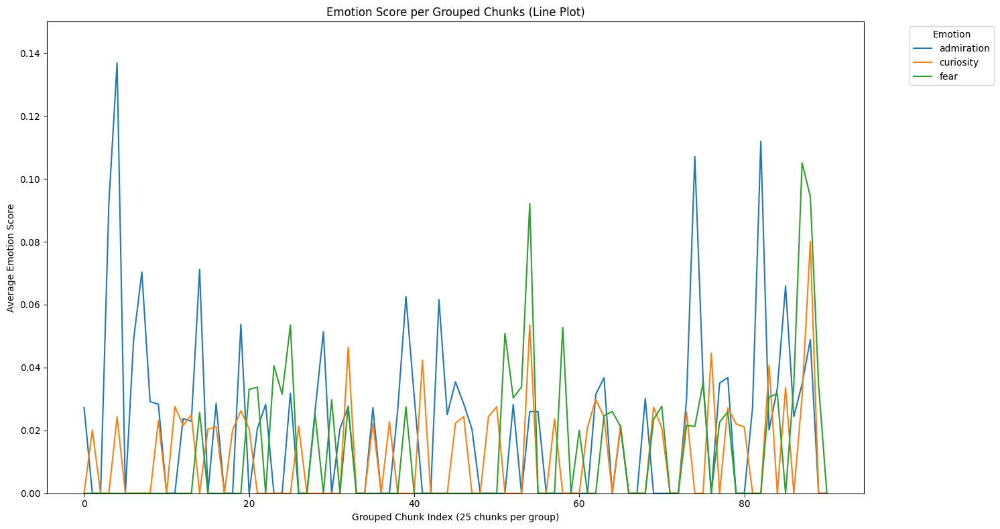

In [ ]:
import matplotlib.pyplot as plt

# Nur diese Emotionen sollen im Plot erscheinen
emotions_to_include = ["disgust", "fear", "admiration", "curiosity"]  # <-- Hier beliebige Emotionen eintragen

# Filtere nur die gewünschten Emotionen (sofern sie in den Spalten vorhanden sind)
emotions_to_plot = [col for col in emotions_df.columns if col in emotions_to_include]


# Emotionen ohne "neutral"
#emotions_to_plot = [col for col in emotions_df.columns if col != "neutral"]

# Gruppiere alle 25 Chunks und berechne den Mittelwert (statt Summe, um Scores zwischen 0 und 1 zu halten)
group_size = 25
grouped = emotions_df[emotions_to_plot].groupby(emotions_df.index // group_size).mean()

# Line Plot
fig, ax = plt.subplots(figsize=(15, 8))
for emotion in grouped.columns:
    ax.plot(grouped.index, grouped[emotion], label=emotion)

# Achsenbeschriftungen und Titel
ax.set_xlabel("Grouped Chunk Index (25 chunks per group)")
ax.set_ylabel("Average Emotion Score")
ax.set_title("Emotion Score per Grouped Chunks (Line Plot)")
ax.set_ylim(0, 0.15)  # Skala von 0 bis 1
ax.legend(title="Emotion", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


In [ ]:
!pip install plotly

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.3/16.3 MB 12.1 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2/2 [plotly]2m1/2 [plotly]


In [ ]:
import plotly.graph_objects as go

fig = go.Figure()

# Add one trace per emotion (initially visible=False)
for i, emotion in enumerate(emotions_df.columns):
    fig.add_trace(
        go.Scatter(
            x=emotions_df.index,
            y=emotions_df[emotion],
            mode='lines',
            name=emotion,
            visible=(emotion == "admiration")  # Show "admiration" by default
        )
    )

# Create dropdown buttons for each emotion
buttons = [
    dict(
        label=emotion,
        method="update",
        args=[{"visible": [e == emotion for e in emotions_df.columns]},
              {"title": f"Emotion Trend: {emotion}"}]
    )
    for emotion in emotions_df.columns if emotion != "neutral"
]

fig.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=buttons,
            x=1.15,
            y=1,
            showactive=True
        )
    ],
    title="Emotion Trend: admiration",
    xaxis_title="Text Chunk Index",
    yaxis_title="Emotion Score",
    width=1000,
    height=600
)

fig.show()

In [ ]:
import plotly.graph_objects as go

# Define wich emotions to plot
emotions_to_plot = [col for col in emotions_df.columns if col != "neutral"]

fig = go.Figure()

# Add a line for each emotion
for emotion in emotions_to_plot:
    fig.add_trace(
        go.Scatter(
            x=emotions_df.index,
            y=emotions_df[emotion],
            mode='lines',
            name=emotion
        )
    )

# Customize layout
fig.update_layout(
    title="Emotion Trends Across the Novel",
    xaxis_title="Text Chunk Index",
    yaxis_title="Emotion Score",
    height=600,
    legend_title="Click emotions to show/hide:"
)

fig.show()


In [ ]:
import plotly.graph_objects as go

# Exclude "neutral" if you don't want it in the plot
emotions_to_plot = [col for col in emotions_df.columns if col != "neutral"]

# Group every 25 chunks together and sum their emotion scores
group_size = 25
grouped = emotions_df[emotions_to_plot].groupby(emotions_df.index // group_size).sum()

fig = go.Figure()

# Add a bar for each emotion (stacked)
for emotion in emotions_to_plot:
    fig.add_trace(
        go.Bar(
            x=grouped.index,
            y=grouped[emotion],
            name=emotion
        )
    )

fig.update_layout(
    barmode='stack',
    title="Stacked Emotion Scores per 25-Chunk Group",
    xaxis_title="Grouped Chunk Index (25 chunks per group)",
    yaxis_title="Total Emotion Score",
    height=600,
    legend_title="Emotion"
)

fig.show()

In [ ]:
import plotly.graph_objects as go

# Define wich emotions to plot
emotions_to_plot = [col for col in emotions_df.columns if col != "neutral"]

fig = go.Figure()

# Add a line for each emotion with custom hover text (chunk)
for emotion in emotions_to_plot:
    fig.add_trace(
        go.Scatter(
            x=emotions_df.index,
            y=emotions_df[emotion],
            mode='lines',
            name=emotion,
            customdata=df_other_model["chunk"],  # Pass the chunk text
            hovertemplate=(
                "<b>Chunk Index:</b> %{x}<br>" +
                "<b>Emotion:</b> %{fullData.name}<br>" +
                "<b>Emotion Score:</b> %{y:.2f}<br>" +
                "<b>Text:</b> %{customdata}<extra></extra>"
            )
        )
    )

# Layout configuration
fig.update_layout(
    title="Emotion Trends Across the Novel",
    xaxis_title="Text Chunk Index",
    yaxis_title="Emotion Score",
    height=600,
    legend_title="Click to toggle emotions"
)

fig.show()


In [27]:
import plotly.graph_objects as go

######

# Define wich emotions to plot
emotions_to_plot = [col for col in emotions_df.columns if col != "neutral"]

fig = go.Figure()

# Add a line for each emotion
for emotion in emotions_to_plot:
    fig.add_trace(
        go.Scatter(
            x=emotions_df.index,
            y=emotions_df[emotion],
            mode='lines',
            name=emotion,
            customdata=df_other_model["chunk"],  # Chunk text for hover
            hovertemplate=(
                "<b>Chunk Index:</b> %{x}<br>" +
                "<b>Emotion:</b> %{fullData.name}<br>" +
                "<b>Emotion Score:</b> %{y:.2f}<br>" +
                "<b>Text:</b> %{customdata}<extra></extra>"
            )
        )
    )

# Layout with zoom/pan enhancements
fig.update_layout(
    title="Emotion Trends Across the Novel",
    xaxis=dict(
        title="Text Chunk Index",
        rangeslider=dict(visible=True),  # Adds a scrollable slider below
        type="linear"
    ),
    yaxis=dict(
        title="Emotion Score"
    ),
    height=600,
    legend_title="Click to toggle emotions",
    dragmode="pan",  # Default drag mode
)

# Enables scroll zoom (wheel-based zooming) when using Jupyter or HTML export
fig.show(config={"scrollZoom": True})


In [47]:
import plotly.graph_objects as go

# Exclude "neutral" if you don't want it in the plot
emotions_to_plot = [col for col in emotions_df.columns
                   # if col != "neutral"
                    ]

# Group every 25 chunks together and sum their emotion scores
group_size = 5
grouped = emotions_df[emotions_to_plot].groupby(emotions_df.index // group_size).sum()


fig = go.Figure()

default_visible = ["anger", "joy", "disapproval", "fear", "surprise", "curiosity", "sadness"]  # Emotions to show by default


# Your custom emotion order (must match column names in emotions_df)
custom_order = [
    "anger", "joy", "disapproval", "fear", "surprise", "curiosity", "sadness"
    'love',
    'gratitude',
    'pride',
    'relief',
    'amusement',
    'admiration',
    'approval',
    'excitement',
    'optimism',
    'caring',
    'desire',
    'realization',
    'confusion',
    'nervousness',
    'embarrassment',
    'annoyance',
    'disappointment',
    'remorse',
    'disgust',
    'grief',
    'neutral'
]


# Loop through custom order
for emotion in custom_order:
    if emotion in emotions_df.columns:
        fig.add_trace(
            go.Scatter(
                x=emotions_df.index,
                y=emotions_df[emotion],
                mode='lines',
                name=emotion,
                customdata=df["chunk"],
                hovertemplate=(
                    "<b>Chunk Index:</b> %{x}<br>" +
                    "<b>Emotion:</b> %{fullData.name}<br>" +
                    "<b>Emotion Score:</b> %{y:.2f}<br>" +
                    "<b>Text:</b> %{customdata}<extra></extra>"
                ),
                visible=True if emotion in default_visible else "legendonly"
            )
        )


# Layout with zoom/pan enhancements
fig.update_layout(
    barmode='stack',
    title="Stacked Emotion Scores per Chunk",
    xaxis=dict(
        title="Chunk Index",
        rangeslider=dict(visible=True),
        type="linear"
    ),
    yaxis=dict(
        title="Emotion Score"
    ),
    height=600,
    legend_title="Emotion",
    dragmode="pan",
    template="plotly_white"
)

fig.show(config={"scrollZoom": True})


In [41]:
id2label

{0: 'admiration',
 1: 'amusement',
 2: 'anger',
 3: 'annoyance',
 4: 'approval',
 5: 'caring',
 6: 'confusion',
 7: 'curiosity',
 8: 'desire',
 9: 'disappointment',
 10: 'disapproval',
 11: 'disgust',
 12: 'embarrassment',
 13: 'excitement',
 14: 'fear',
 15: 'gratitude',
 16: 'grief',
 17: 'joy',
 18: 'love',
 19: 'nervousness',
 20: 'optimism',
 21: 'pride',
 22: 'realization',
 23: 'relief',
 24: 'remorse',
 25: 'sadness',
 26: 'surprise',
 27: 'neutral'}

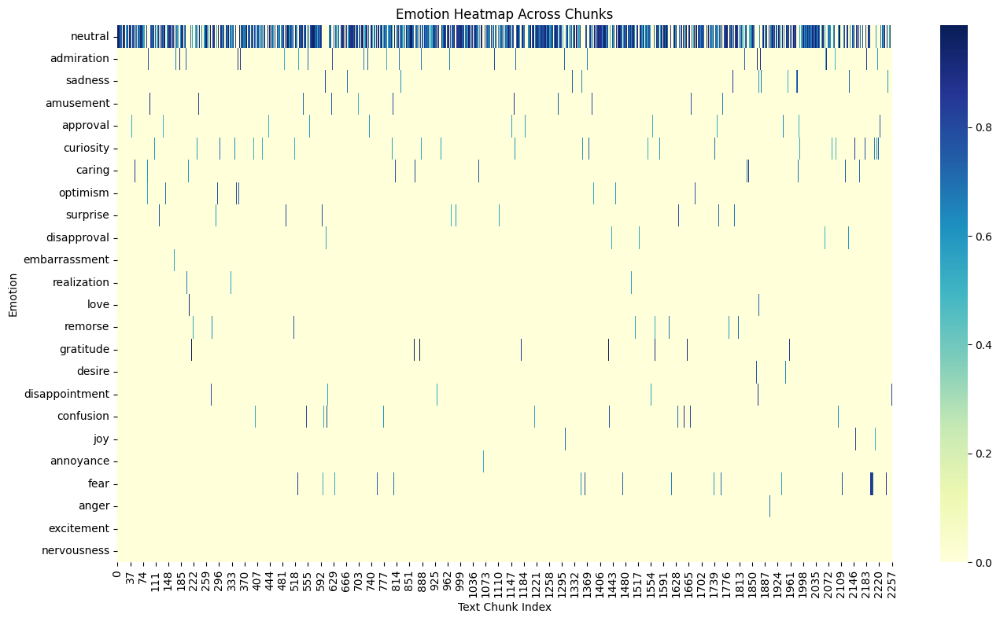

In [ ]:
# Emotion intensity heatmap

import seaborn as sns

plt.figure(figsize=(14, 8))
sns.heatmap(emotions_df.T, cmap='YlGnBu', cbar=True)
plt.title("Emotion Heatmap Across Chunks")
plt.xlabel("Text Chunk Index")
plt.ylabel("Emotion")
plt.tight_layout()
plt.show()

<Axes: title={'center': 'Total Emotion Scores Across the Novel'}>

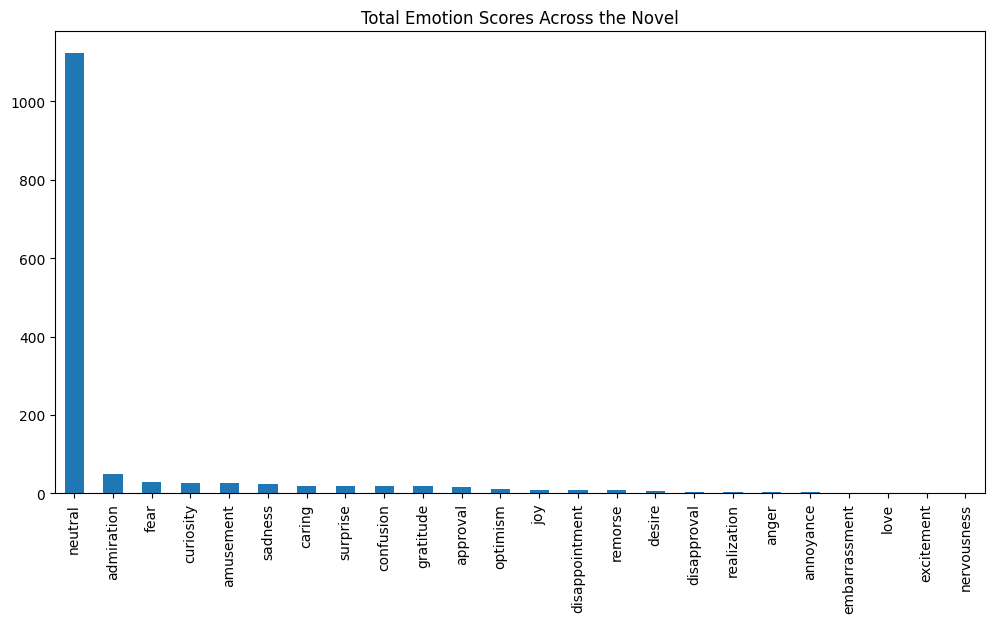

In [ ]:
# Top emotions overall

emotions_df.sum().sort_values(ascending=False).plot(
    kind='bar', figsize=(12, 6), title='Total Emotion Scores Across the Novel'
)